In [116]:
import sys
sys.path.append('../')

import jraph
import numpy as np
import ase
import e3nn_jax as e3nn
import jax
import jax.numpy as jnp
import plotly.graph_objects as go
import collections

In [2]:
%load_ext autoreload

In [158]:
%autoreload 2
from analyses import analysis
from symphony import loss
from symphony import datatypes
from symphony.models import utils
from symphony.data import fragments
from symphony.data import input_pipeline
from symphony.data import qm9

# Multiple focuses

In [64]:
senders = np.asarray([0, 0, 0, 1, 1, 2, 2, 3, 3, 4])
receivers = 4 - senders

mask = np.asarray([False, True, True, True, True, True, True, True, False, True])
focus_nodes = np.asarray([0, 2])

def choose_target(focus_node, key):
    target = jax.random.choice(key, receivers, p=((senders == focus_node) & mask))
    return target

rngs = jax.random.split(jax.random.PRNGKey(1), len(focus_nodes))
jax.vmap(choose_target)(focus_nodes, rngs)

Array([4, 2], dtype=int32)

In [144]:
gain_ratio_by_length = collections.defaultdict(list)
for molecule in qm9.load_qm9("/Users/ameyad/Documents/spherical-harmonic-net/qm9_data", use_edm_splits=True, check_molecule_sanity=False)[:1000]:
    graph = input_pipeline.ase_atoms_to_jraph_graph(
        molecule, utils.ATOMIC_NUMBERS, nn_cutoff=5.
    )
    sequence = fragments.generate_fragments(
        jax.random.PRNGKey(0),
        graph,
        n_species=len(utils.ATOMIC_NUMBERS),
        mode="radius",
        heavy_first=True
    )
    gain_ratio = len(list(sequence)) / len(molecule)
    gain_ratio_by_length[len(molecule)].append(gain_ratio)


[11:04:13] Warning: molecule is tagged as 3D, but all Z coords are zero
[11:04:13] Warning: molecule is tagged as 3D, but all Z coords are zero


/Users/ameyad/Documents/spherical-harmonic-net/qm9_data/edm_splits.npz
num_nodes 13
visited [8]
focus_probability [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
focus_nodes [7]
target_nodes [6]
visited [8 7]
focus_probability [0.  0.  0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0.  0. ]
focus_nodes [6 7]
target_nodes [5 1]
visited [6 7 8]
focus_probability [0.         0.66666667 0.         0.         0.         0.33333333
 0.         0.         0.         0.         0.         0.
 0.        ]
focus_nodes [1 5]
target_nodes [0 4]
visited [1 5 6 7 8]
focus_probability [0.  0.5 0.  0.  0.5 0.  0.  0.  0.  0.  0.  0.  0. ]
focus_nodes [1 4]
target_nodes [2 2]
visited [0 1 4 5 6 7 8]
focus_probability [0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
focus_nodes [2]
target_nodes [3]
visited [0 1 2 4 5 6 7 8]
focus_probability [0.6 0.  0.  0.  0.  0.  0.  0.2 0.2 0.  0.  0.  0. ]
focus_nodes [0 7 8]
target_nodes [10 12 12]
visited [0 1 2 3 4 5 6 7 8]
focus_probability [0.5 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.5 0

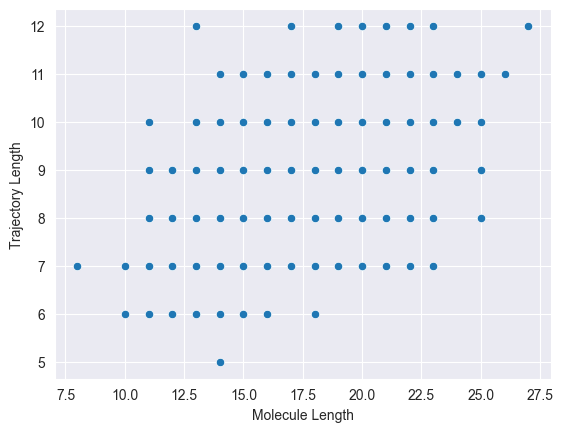

In [154]:
import matplotlib.pyplot as plt
import seaborn as sns
data = [
    (length, length * gain_ratio)  for length in gain_ratio_by_length for gain_ratio in gain_ratio_by_length[length] 
]
molecule_lengths = [d[0] for d in data]
trajectory_lengths = [d[1] for d in data]
sns.set_style("darkgrid")
sns.scatterplot(x=molecule_lengths, y=trajectory_lengths)
plt.xlabel("Molecule Length")
plt.ylabel("Trajectory Length")
plt.show();

In [157]:
molecule, _ = analysis.construct_molecule("C6H6")
graph = input_pipeline.ase_atoms_to_jraph_graph(
    molecule, utils.ATOMIC_NUMBERS, nn_cutoff=5.
)
sequence = fragments.generate_fragments(
    jax.random.PRNGKey(0),
    graph,
    n_species=len(utils.ATOMIC_NUMBERS),
    mode="radius",
    heavy_first=True
)

gain_ratio = len(list(sequence)) / len(molecule)
print(gain_ratio)

num_nodes 12
visited [5]
focus_probability [0.  0.  0.  0.  0.5 0.5 0.  0.  0.  0.  0.  0. ]
focus_nodes [4 5]
target_nodes [3 0]
visited [5 4]
focus_probability [0.5 0.  0.  0.5 0.  0.  0.  0.  0.  0.  0.  0. ]
focus_nodes [0 3]
target_nodes [1 2]
visited [0 3 4 5]
focus_probability [0.16666667 0.16666667 0.16666667 0.16666667 0.16666667 0.16666667
 0.         0.         0.         0.         0.         0.        ]
focus_nodes [0 1 2 3 4 5]
target_nodes [ 6  7  8  9 10 11]
visited [0 1 2 3 4 5]
visited_nodes [ 0  1  2  3  4  5  6  7  8  9 10 11]
0.4166666666666667


## Jittable Merge

We need to merge atoms that are overlapping (or close to overlapping).
How to do this in a JIT-friendly way?

In [190]:
def naive_merge(graph: datatypes.Fragments, merge_cutoff: float):
    segment_ids = utils.get_segment_ids(graph.n_node, num_nodes=None)
    positions = graph.nodes.positions
    distance_matrix = jnp.linalg.norm(
        positions[None, :, :] - positions[:, None, :], axis=-1
    )
    num_nodes = distance_matrix.shape[0]
    overlapping_edges = (distance_matrix <= merge_cutoff)
    node_indices_mask = (jnp.arange(num_nodes)[:, None] < jnp.arange(num_nodes)[None, :])
    overlapping_edges = jnp.where(node_indices_mask, overlapping_edges, 0)
    overlapping_edges = overlapping_edges & (segment_ids[None, :] == segment_ids[:, None])
    overlapping_indices1, overlapping_indices2 = jnp.nonzero(overlapping_edges, size=None, fill_value=-1)
    overlapping_min = jnp.minimum(overlapping_indices1, overlapping_indices2)
    overlapping_max = jnp.maximum(overlapping_indices1, overlapping_indices2)
    def update_array(indices, args):
        index, replace_index = args
        return (jnp.where(indices == index, replace_index, indices), None)
    senders, _ = jax.lax.scan(update_array, graph.senders, (overlapping_max, overlapping_min))
    receivers, _ = jax.lax.scan(update_array, graph.receivers, (overlapping_max, overlapping_min))

    print(senders, receivers)

molecule, _ = analysis.construct_molecule("C6H6")
# Add an extra atom.
appended_molecule = ase.Atoms(
    positions=np.concatenate([np.asarray(molecule.positions), [[ 0., 1.395248,  0.]]], axis=0),
    numbers=np.concatenate([np.asarray(molecule.numbers), [0]], axis=0)
)
graph = input_pipeline.ase_atoms_to_jraph_graph(
    appended_molecule, utils.ATOMIC_NUMBERS, nn_cutoff=5.
)
naive_merge(graph, merge_cutoff=0.1)

[ 1  2  3  4  5  6  7  8  9 10 11  0  0  2  3  4  5  6  7  8  9 10 11  0
  0  1  3  4  5  6  7  8  9 10 11  0  0  1  2  4  5  6  7  8  9 10 11  0
  0  1  2  3  5  6  7  8  9 10 11  0  0  1  2  3  4  6  7  8  9 10 11  0
  0  1  2  3  4  5  7  8  9 10 11  0  0  1  2  3  4  5  6  8  9 10 11  0
  0  1  2  3  4  5  6  7  9 10 11  0  0  1  2  3  4  5  6  7  8 10 11  0
  0  1  2  3  4  5  6  7  8  9 11  0  0  1  2  3  4  5  6  7  8  9 10  0
  0  1  2  3  4  5  6  7  8  9 10 11] [ 0  0  0  0  0  0  0  0  0  0  0  0  1  1  1  1  1  1  1  1  1  1  1  1
  2  2  2  2  2  2  2  2  2  2  2  2  3  3  3  3  3  3  3  3  3  3  3  3
  4  4  4  4  4  4  4  4  4  4  4  4  5  5  5  5  5  5  5  5  5  5  5  5
  6  6  6  6  6  6  6  6  6  6  6  6  7  7  7  7  7  7  7  7  7  7  7  7
  8  8  8  8  8  8  8  8  8  8  8  8  9  9  9  9  9  9  9  9  9  9  9  9
 10 10 10 10 10 10 10 10 10 10 10 10 11 11 11 11 11 11 11 11 11 11 11 11
  0  0  0  0  0  0  0  0  0  0  0  0]


# Multiple Targets

In [11]:

radii = jnp.linspace(0.9, 2.0, 5)

def position_probability_grid(target_position):
    radius_weights = loss.target_position_to_radius_weights(target_position, radius_rbf_variance=1e-5, radii=radii)
    log_angular_coeffs = loss.target_position_to_log_angular_coeffs(target_position, target_position_inverse_temperature=1000, lmax=5)
    position_probs = utils.compute_grid_of_joint_distribution(radius_weights, log_angular_coeffs, res_alpha=89, res_beta=45, quadrature="gausslegendre")
    return position_probs

traces = []
for seed in range(1):
    target_positions = jnp.asarray([[1., 0., 0.], [0., 1., 0.], [0., 0., 1.], [1., 1., 1.]])
    target_positions = jax.random.normal(jax.random.PRNGKey(seed), shape=(4, 3))
    mask = jnp.asarray([True, False, True, True])
    position_probs = (jax.vmap(position_probability_grid)(target_positions) * mask[:, None])
    position_probs.grid_values = position_probs.grid_values.mean(axis=0)

    count = 0
    cmin = 0.0
    cmax = position_probs.grid_values.max().item()
    for i in range(len(radii)):
        prob_r = position_probs[i]

        # Skip if the probability is too small.
        if prob_r.grid_values.max() < 1e-2 * cmax:
            continue

        count += 1
        surface_r = go.Surface(
            **prob_r.plotly_surface(radius=radii[i]),
            colorscale=[[0, "rgba(4, 59, 192, 0.)"], [1, "rgba(4, 59, 192, 1.)"]],
            showscale=False,
            cmin=cmin,
            cmax=cmax,
            name="Position Probabilities",
            legendgroup="Position Probabilities",
            showlegend=(count == 1),
        )
        traces.append(surface_r)

go.Figure(traces)

# Radial Map Idea

In [ ]:
log_angular_coeffs = e3nn.IrrepsArray("1o", jnp.ones(3))
radii = jnp.asarray([0.5, 1., 1.5])
radial_weights = jnp.asarray([0., 0., 1.5])
radial_weights = radial_weights / radial_weights.sum()
position_probs = utils.compute_grid_of_joint_distribution(
    radial_weights,
    log_angular_coeffs,
    res_beta=180,
    res_alpha=359,
    quadrature="soft"
)

In [ ]:
rng = jax.random.PRNGKey(0)
vector = utils.sample_from_position_distribution(position_probs, radii, rng)

In [ ]:
jnp.linalg.norm(vector, axis=-1)

Array(1.5000001, dtype=float32)

An example with multiple targets!

In [ ]:
targets = jnp.asarray([
    [1., 0., -1.5],
    [0., -1., 1.],
    [-2., 1., 2.],
])

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter3d(
    x=[0],
    y=[0],
    z=[0],
    mode="markers",
    marker=dict(
        size=10,
        color="blue"
    ),
    name="Focus"
))
fig.add_trace(go.Scatter3d(
    x=targets[:, 0],
    y=targets[:, 1],
    z=targets[:, 2],
    mode="markers",
    marker=dict(
        size=5,
        color="red"
    ),
    name="Targets"
))
fig

In [ ]:
lmax = 10
beta = 1

In [ ]:
log_angular_coeffs = beta * e3nn.sum(e3nn.s2_dirac(targets, lmax=lmax, p_val=1, p_arg=-1), axis=0)
log_angular_coeffs

1x0e+1x1o+1x2e+1x3o+1x4e+1x5o+1x6e+1x7o+1x8e+1x9o+1x10e
[ 2.38732427e-01 -1.54325813e-02 -5.15180193e-02  7.46668801e-02
 -2.79225945e-01 -6.84893876e-02 -1.03798687e-01 -8.56116936e-02
  1.36320189e-01  6.47150874e-02 -1.20803915e-01 -3.33160795e-02
 -4.85575199e-02  2.05826044e-01 -1.44148350e-01 -7.82772899e-03
 -1.25357389e-01 -9.86359790e-02  1.49551228e-01  9.32022482e-02
 -4.51304903e-03 -1.40385896e-01  1.15490273e-01 -2.23472074e-01
 -2.19668865e-01  1.34606451e-01  1.34818690e-08 -1.35443538e-01
  1.33553743e-01  9.61154997e-02  1.87121093e-01 -1.99315876e-01
 -1.19521499e-01  1.44280776e-01 -2.57723212e-01  1.16611145e-01
  2.07988024e-01  1.17221147e-01  1.01066366e-01  9.12565216e-02
 -5.14963195e-02 -7.57518485e-02 -7.67575651e-02  2.19561934e-01
  6.62162080e-02 -7.11604580e-02  2.35359401e-01 -2.00672418e-01
 -1.54421628e-01 -7.16474354e-02  1.74742937e-01  4.96147200e-03
 -1.04858975e-08  1.97107941e-01 -8.40232521e-02 -1.46736294e-01
 -9.03152078e-02  4.46821600e-02  

In [ ]:
angular_logits = e3nn.to_s2grid(log_angular_coeffs, res_beta=180, res_alpha=359, quadrature="soft")
angular_probs = angular_logits.apply(jnp.exp)
Z = angular_probs.integrate().array.sum()
angular_probs = angular_probs.apply(lambda x: x / Z)
fig.add_trace(
    go.Surface(angular_probs.plotly_surface(), name="Angular logits", colorbar={"thickness": 10, "len": 0.6})
)


In [ ]:
radial_coeffs = e3nn.sum(e3nn.s2_dirac(targets, lmax=lmax, p_val=1, p_arg=-1) * jnp.linalg.norm(targets, axis=-1, keepdims=True), axis=0)
radial_field = e3nn.to_s2grid(radial_coeffs, res_beta=180, res_alpha=359, quadrature="soft") / 4
go.Figure(
    go.Surface(
        radial_field.plotly_surface(scale_radius_by_amplitude=True),
        name="Radial Field",
        colorbar={"thickness": 10, "len": 0.75}
    )
)

In [ ]:
rngs = jax.random.split(rng, 1000)
angular_samples = jax.vmap(utils.sample_from_angular_distribution, in_axes=(None, 0))(angular_probs, rngs)
vectors = jax.vmap(utils.sample_from_angular_distribution_with_radial_field, in_axes=(None, None, 0))(angular_probs, radial_field, rngs)

In [ ]:
fig.add_trace(go.Scatter3d(
    x=vectors[:, 0],
    y=vectors[:, 1],
    z=vectors[:, 2],
    mode="markers",
    marker=dict(
        size=5,
        color="green"
    ),
    name="Samples"
))
fig